In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import plotly.graph_objects as go
import h5py

In [2]:
#file = h5py.File('/sdf/group/neutrino/sfogarty/ND_prototype_files/charge_data/module-3/tpc_12-packet-2023_02_22_12_45_CET_module-3_events.h5', 'r')
file = h5py.File('/sdf/group/neutrino/sfogarty/ND_prototype_files/charge_data/module-0/datalog_2021_04_04_00_41_40_CEST_module-0_events_60s_to_360s.h5', 'r')

In [12]:
file.keys()

<KeysViewHDF5 ['large_clusters', 'large_clusters_hits', 'large_clusters_matched_light', 'small_clusters', 'small_clusters_hits', 'small_clusters_matched_light']>

In [9]:
file['large_clusters_matched_light'].dtype

dtype([('tai_s', '<i4'), ('tai_ns', '<i8'), ('unix', '<i8'), ('channel_0a7a314c', 'u1', (58,)), ('channel_0a7b54bd', 'u1', (58,)), ('voltage_0a7a314c', '<i2', (58, 256)), ('voltage_0a7b54bd', '<i2', (58, 256))])

In [35]:
np.where(file['large_clusters']['nhit'] > 500)[0]

array([   46,    52,    71,   141,   153,   224,   253,   291,   314,
         327,   375,   401,   439,   780,   866,   874,   954,  1115,
        1147,  1263,  1291,  1390,  1396,  1414,  1603,  1622,  1633,
        1685,  1705,  1707,  1775,  1991,  1996,  2112,  2159,  2465,
        2496,  2502,  2662,  2702,  2753,  2847,  2883,  3053,  3157,
        3229,  3425,  3434,  3447,  3634,  3783,  3862,  4006,  4131,
        4184,  4311,  4414,  4435,  4566,  4717,  4718,  4783,  4825,
        4957,  5010,  5035,  5059,  5124,  5456,  5490,  5562,  5593,
        5596,  5663,  5665,  5668,  5833,  5841,  5929,  6279,  6303,
        6367,  6679,  6720,  6829,  6889,  6975,  7186,  7226,  7244,
        7270,  7290,  7298,  7413,  7526,  7593,  7595,  7640,  7838,
        7941,  7988,  8012,  8041,  8185,  8288,  8443,  8524,  8656,
        8658,  8673,  8736,  8807,  9040,  9092,  9187,  9237,  9291,
        9328,  9551,  9674,  9831,  9907,  9918,  9984, 10003, 10063,
       10171, 10305,

In [40]:
eventID = 866
large_clusters = file['large_clusters']
large_clusters_hits = file['large_clusters_hits']
small_clusters = file['small_clusters']
small_clusters_hits = file['small_clusters_hits']

event = large_clusters[eventID]
event_hits = large_clusters_hits[large_clusters_hits['cluster_index'] == eventID]
print('event: ', event)
print('dtype: ', large_clusters_hits.dtype)

# match to charge events
t_min = large_clusters[eventID]['t_min']
t_max = large_clusters[eventID]['t_max']
unix = large_clusters[eventID]['unix']

unix_window = 1
PPS_window = 189.2*1e3/2

t_small_clusters = small_clusters['t']
unix_small_clusters = small_clusters['unix']

PPS_min_match = t_min - PPS_window < t_small_clusters
PPS_max_match = t_max + PPS_window > t_small_clusters
unix_match = unix == unix_small_clusters
PPS_match = (PPS_min_match) & (PPS_max_match) & (unix_match)
indices_matched = np.where(PPS_match)[0]
small_clusters_matched = small_clusters[indices_matched]

#print(event_hits['t'])
import plotly.graph_objects as go
from plotly.subplots import make_subplots
x_limits = [-310,310]
y_limits = [-620,620]
#event_t = (event_hits['t'] - np.min(event_hits['t']))*1e-3

smallest_t = []
smallest_t.append(np.min(event_hits['t']))
for i in range(len(indices_matched)):
    index = indices_matched[i]
    hits = small_clusters_hits[np.array(small_clusters_hits['cluster_index']) == index]
    smallest_t.append(np.min(hits['t']))
minT = np.min(smallest_t)
event_t = (event_hits['t'] - minT)*1e-3
fig = go.Figure(data=[go.Scatter3d(x=event_hits['x'],y=event_t,z=event_hits['y'],\
                                   mode='markers', marker=dict(size=3))])

for i in range(len(indices_matched)):
    index = indices_matched[i]
    hits = small_clusters_hits[np.array(small_clusters_hits['cluster_index']) == index]
    trace = go.Scatter3d(x=hits['x'],y=(hits['t']-minT)*1e-3,z=hits['y'], marker=dict(size=3))
    fig.add_trace(trace)
    
fig.update_layout(scene_aspectmode='manual', scene_aspectratio=dict(x=1,y=1,z=2))
fig.update_layout(scene=dict(\
                            xaxis_title='x [mm]',\
                            yaxis_title='t [µs]',\
                            zaxis_title='y [mm]',\
                            xaxis=dict(range=x_limits,tickfont=dict(size=10)),\
                            zaxis=dict(range=y_limits,tickfont=dict(size=10)),\
                            yaxis=dict(tickfont=dict(size=10))))

#fig.update_xaxes(scaleanchor='x',scaleratio=1)
#fig.update_yaxes(scaleanchor='x',scaleratio=100)
#fig.update_layout(width=1500, height=600)
fig.show()

event:  (554, 6756.00294387, 1, 797468125, 797410000, 1617489734, 0, -1)
dtype:  [('q', '<f8'), ('io_group', '<i4'), ('t', '<i8'), ('x', '<f8'), ('y', '<f8'), ('z', '<f8'), ('unix', '<i8'), ('cluster_index', '<i4')]


In [11]:
small_clusters = file['small_clusters']
small_clusters_hits = file['small_clusters_hits']

charge = small_clusters['q']
q_hist = go.Histogram(x=charge, nbinsx = 1500)
layout = go.Layout(title='module-0 39Ar candidates', xaxis=dict(title='q (ke-)'))
fig = go.Figure(data=q_hist, layout=layout)
fig.show()

In [41]:
from tqdm import tqdm
#eventID = 5
large_clusters = file['large_clusters']
small_clusters = file['small_clusters']
unix_window = 1
PPS_window = 189.2*1e3
near_cosmic = np.zeros(len(small_clusters), dtype=bool)

# find small clusters near large clusters
for eventID in tqdm(range(len(large_clusters))):
    t_min = large_clusters[eventID]['t_min']
    t_max = large_clusters[eventID]['t_max']
    unix = large_clusters[eventID]['unix']
    
    t_small_clusters = small_clusters['t']
    unix_small_clusters = small_clusters['unix']

    PPS_min_match = t_min - PPS_window < t_small_clusters
    PPS_max_match = t_max + PPS_window > t_small_clusters
    unix_match = unix == unix_small_clusters
    PPS_match = (PPS_min_match) & (PPS_max_match) & (unix_match)
    #indices_matched = np.where(PPS_match)[0]
    near_cosmic += PPS_match

not_near_cosmic = np.invert(near_cosmic)

100%|██████████| 30350/30350 [26:01<00:00, 19.44it/s]


In [ ]:
print('Number of small clusters near cosmic track = ',np.sum(near_cosmic))
print('Number of small clusters not near cosmic track = ',np.sum(not_near_cosmic))

# histogram without veto
charge = small_clusters['q']
q_hist = go.Histogram(x=charge,name='No cosmic veto',opacity=0.4,histfunc='count',xbins=dict(start=0, end=50, size=0.5),histnorm='probability density')

# histogram with veto
charge_cosmic_veto = small_clusters['q'][not_near_cosmic]
#q_hist_veto = go.Histogram(x=charge_cosmic_veto, nbinsx = 1000)
q_hist_veto = go.Histogram(x=charge_cosmic_veto,name='Cosmic veto applied',\
                      opacity=0.4,histfunc='count',\
                      xbins=dict(start=0, end=50, size=0.5),\
                      histnorm='probability density')

x_array = small_clusters['x']
y_array = small_clusters['y']
z_array = small_clusters['z']
# cut only the noisy parts of the two noisy tiles (module-0)
cut_io1 = (y_array > 0) & (y_array < 310) & (x_array < -250) & (x_array > -310) & (z_array > 0)
cut_io2 = (y_array < -310) & (y_array > -620) & (x_array > 250) & (x_array < 310) & (z_array < 0)
cut_total_inverted = np.invert(cut_io1 + cut_io2)
# histogram with pixel plane cut
charge_pixel_plane_cut = small_clusters['q'][cut_total_inverted]
q_hist_pixel_plane_cut = go.Histogram(x=charge_pixel_plane_cut,name='Noisy tile cut applied',\
                      opacity=0.4,histfunc='count',\
                      xbins=dict(start=0, end=50, size=0.5),\
                      histnorm='probability density')

layout = go.Layout(title='module-0 39Ar candidates with cosmic veto', xaxis=dict(title='q (ke-)'))
fig = go.Figure(data=q_hist_veto, layout=layout)
fig.update_layout(barmode='overlay')
fig.add_trace(q_hist)
fig.add_trace(q_hist_pixel_plane_cut)
fig.show()

In [41]:
#small_clusters_vetoed = small_clusters[not_near_cosmic]
## find large clusters near other large clusters
from tqdm import tqdm
#eventID = 5
large_clusters = file['large_clusters']
unix_window = 1
PPS_window = 189.2*1e3
eventID = 25
# find small clusters near large clusters
t_min = large_clusters[eventID]['t_min']
t_max = large_clusters[eventID]['t_max']
unix = large_clusters[eventID]['unix']

tmin_large_clusters = large_clusters['t_min']
tmax_large_clusters = large_clusters['t_max']
unix_large_clusters = large_clusters['unix']

PPS_min_match = (t_min - PPS_window < tmin_large_clusters) & (t_min - PPS_window < tmax_large_clusters)
PPS_max_match = (t_max + PPS_window > tmin_large_clusters) & (t_max + PPS_window > tmax_large_clusters)
unix_match = unix == unix_large_clusters
PPS_match = (PPS_min_match) & (PPS_max_match) & (unix_match)
indices_matched = np.where(PPS_match)[0]
print(indices_matched)

import plotly.graph_objects as go
from plotly.subplots import make_subplots
x_limits = [-310,310]
y_limits = [-620,620]

event = large_clusters[eventID]
event_hits = large_clusters_hits[large_clusters_hits['cluster_index'] == eventID]
print('event: ', event)
print('dtype: ', large_clusters_hits.dtype)

smallest_t = []
smallest_t.append(np.min(event_hits['t']))
for i in range(len(indices_matched)):
    index = indices_matched[i]
    hits = large_clusters_hits[np.array(large_clusters_hits['cluster_index']) == index]
    smallest_t.append(np.min(hits['t']))
minT = np.min(smallest_t)
event_t = (event_hits['t'] - minT)*1e-3
fig = go.Figure(data=[go.Scatter3d(x=event_hits['x'],y=event_t,z=event_hits['y'],\
                                   mode='markers', marker=dict(size=2))])

for i in range(len(indices_matched)):
    index = indices_matched[i]
    hits = large_clusters_hits[np.array(large_clusters_hits['cluster_index']) == index]
    trace = go.Scatter3d(x=hits['x'],y=(hits['t']-minT)*1e-3,z=hits['y'], mode='markers',marker=dict(size=2))
    fig.add_trace(trace)

fig.update_layout(scene_aspectmode='manual', scene_aspectratio=dict(x=1,y=1,z=2))
fig.update_layout(scene=dict(\
                            xaxis_title='x [mm]',\
                            yaxis_title='t [µs]',\
                            zaxis_title='y [mm]',\
                            xaxis=dict(range=x_limits,tickfont=dict(size=10)),\
                            zaxis=dict(range=y_limits,tickfont=dict(size=10)),\
                            yaxis=dict(tickfont=dict(size=10))))

#fig.update_xaxes(scaleanchor='x',scaleratio=1)
#fig.update_yaxes(scaleanchor='x',scaleratio=100)
#fig.update_layout(width=1500, height=600)
fig.show()

[25 26]
event:  (87, 1150.2389916, 1, 240065000, 240035625, 1617489730, 1, 14)
dtype:  [('q', '<f8'), ('io_group', '<i4'), ('t', '<i8'), ('x', '<f8'), ('y', '<f8'), ('z', '<f8'), ('unix', '<i8'), ('cluster_index', '<i4')]


In [42]:
small_clusters.dtype

dtype([('nhit', '<i4'), ('q', '<f8'), ('io_group', '<i4'), ('t', '<i8'), ('x', '<f8'), ('y', '<f8'), ('z', '<f8'), ('unix', '<i8'), ('matched', '<i4'), ('light_index', '<i4')])

In [20]:
q_hist

Histogram({
    'histfunc': 'count',
    'name': 'No cosmic veto',
    'opacity': 0.4,
    'x': array([10.3743497 , 14.9876371 ,  6.60668452, ..., 17.00577615, 18.99712382,
                 9.26656827]),
    'xbins': {'end': 20, 'size': 1, 'start': 0}
})

In [4]:
nhit_large_clusters = file['large_clusters']['nhit']
q_large_clusters = file['large_clusters']['q']

In [11]:
nhit_hist = go.Histogram(x=nhit_large_clusters, nbinsx = 1000)
layout = go.Layout(title='module-3 large clusters', xaxis=dict(title='nhit'))
fig = go.Figure(data=nhit_hist, layout=layout)
fig.show()

In [15]:
q_hist = go.Histogram(x=q_large_clusters, nbinsx = 1500)
layout = go.Layout(title='module-3 large clusters', xaxis=dict(title='q (ke-)'))
fig = go.Figure(data=q_hist, layout=layout)
fig.show()

In [10]:
timestamps_charge = file['small_clusters']['t']

In [8]:
import plotly.graph_objects as go
fig = go.Figure()
#fig.add_trace(go.Scatter(x=np.arange(0,len(timestamps),1), y=timestamps))
fig.add_trace(go.Scatter(x=np.arange(0,len(timestamps_charge),1), y=timestamps_charge))
fig.show()

In [11]:
import plotly.graph_objects as go
fig = go.Figure()
#fig.add_trace(go.Scatter(x=np.arange(0,len(timestamps),1), y=timestamps))
fig.add_trace(go.Scatter(x=np.arange(0,len(timestamps_charge),1), y=timestamps_charge))
fig.show()

In [4]:
file.keys()

<KeysViewHDF5 ['large_clusters', 'small_clusters']>

In [11]:
file['small_clusters'][file['small_clusters']['matched'] == 1]

array([(1,  5.89606232, 1, 102843125, -308.,  206. , -304., 1617489730, 1,    0),
       (1,  7.01137538, 2, 102811250, -232.,  401. ,  304., 1617489730, 1,    0),
       (1, 15.45518688, 2, 121918125,  299., -290. ,  304., 1617489730, 1,    1),
       ...,
       (1, 26.48438965, 2, 941337500,  188., -507. ,  304., 1617489739, 1, 1587),
       (1, 14.77895657, 2, 990397500, -197., -343. ,  304., 1617489739, 1, 1593),
       (2, 40.41315677, 2, 990395937, -201., -414.5,  304., 1617489739, 1, 1593)],
      dtype=[('nhit', '<i4'), ('q', '<f8'), ('io_group', '<i4'), ('t', '<i8'), ('x', '<f8'), ('y', '<f8'), ('z', '<f8'), ('unix', '<i8'), ('matched', '<i4'), ('light_index', '<i4')])

In [27]:
light_event = 5
matched_charge = file['small_clusters'][file['small_clusters']['matched'] == 1]
matched_light = file['small_clusters_matched_light']
matched_charge_one_event = matched_charge[matched_charge['light_index'] == light_event]
print('matched charge events: ')
print(matched_charge_one_event)
print(matched_charge_one_event.dtype)
print('light event: ')
print('tai_ns: ', matched_light[light_event]['tai_ns'], ', unix: ', matched_light[light_event]['unix'])

matched charge events: 
[(2, 35.6285094 , 1, 158379062, 283., -50., -304., 1617489730, 1, 5)
 (1, 13.90056861, 1, 158376250, 285., -50., -304., 1617489730, 1, 5)]
[('nhit', '<i4'), ('q', '<f8'), ('io_group', '<i4'), ('t', '<i8'), ('x', '<f8'), ('y', '<f8'), ('z', '<f8'), ('unix', '<i8'), ('matched', '<i4'), ('light_index', '<i4')]
light event: 
tai_ns:  158315770 , unix:  1617489730


tai_ns:  121861574 , unix:  1617489730


Text(0, 0.5, 'y [mm]')

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …
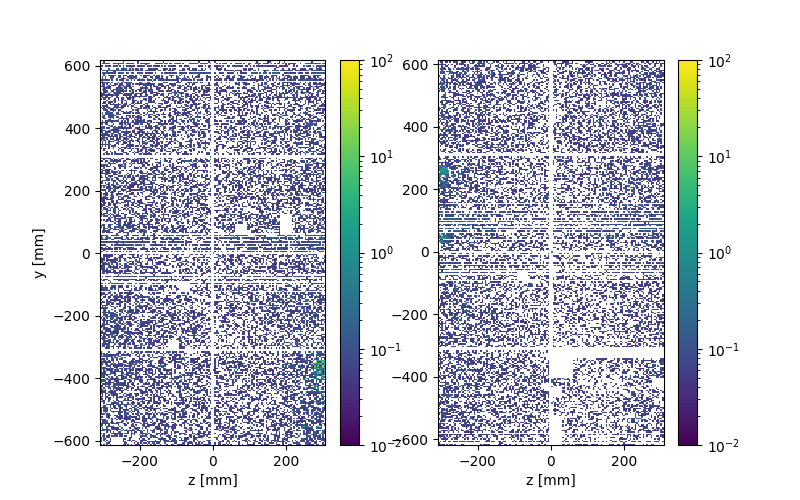

In [9]:
# plot the charge events 
%matplotlib widget
events = file['small_clusters']
y_io1 = events[events['io_group'] == 1]['x']
y_io2 = events[events['io_group'] == 2]['x']
z_io1 = events[events['io_group'] == 1]['y']
z_io2 = events[events['io_group'] == 2]['y']

Range = [[-310, 310],[-620, 620]]
x_bins = 140
y_bins = 2*x_bins
time = 20 # s
fig, axes = plt.subplots(nrows=1, ncols=2, sharex=False, sharey=False, figsize=(8,5))
cmap = plt.cm.jet
#H1 = axes[0].hist2d(y_io1, z_io1, bins = [x_bins,y_bins],range=Range,cmap=cmap,norm = colors.LogNorm(vmin=1e-8,vmax=1e-3),density=True)
H1 = axes[0].hist2d(y_io1, z_io1, bins = [x_bins,y_bins], weights=np.ones_like(y_io1)*1/time,norm = colors.LogNorm(vmin=1e-2,vmax=1e+2))
fig.colorbar(H1[3], ax=axes[0])
#H2 = axes[1].hist2d(y_io2, z_io2, bins = [x_bins,y_bins],range=Range,cmap=cmap,norm = colors.LogNorm(vmin=1e-8,vmax=1e-3),density=True)
H2 = axes[1].hist2d(y_io2, z_io2, bins = [x_bins,y_bins], weights=np.ones_like(y_io2)*1/time,norm = colors.LogNorm(vmin=1e-2,vmax=1e+2))
fig.colorbar(H2[3], ax=axes[1])
#axes[0].set_title('io group 1')
#axes[1].set_title('io_group 2')
#fig.suptitle(r'$^{39} Ar$ $\beta-$ candidates spatial distribution (module-0 data)')
axes[0].set_xlabel('z [mm]')
axes[1].set_xlabel('z [mm]')
axes[0].set_ylabel('y [mm]')

In [14]:
events.dtype.names

('nhit', 'q', 'io_group', 't', 'x', 'y', 'z', 'unix', 'matched', 'light_index')

In [15]:
file.keys()

<KeysViewHDF5 ['large_clusters', 'small_clusters']>